In [2]:
1+2

3

In [3]:
include("speciale_tools.jl")
import JLD
import PyPlot
import Distributions
import LinearAlgebra

In [4]:

function loss_rg_fit(VV,VH, seed_mask, rg_mask_change,target_mu,target_sigma, distance_list, d)

    rg_mask_int = ((VV .< target_mu[1]) .& (VH .< target_mu[2])) .| (distance_list .< d)
    rg_mask = rg_mask_change .& rg_mask_int
    flood_mask,steps = region_growing(seed_mask,rg_mask_int .& rg_mask_change);
    loss = loss_2d_gauss(vec(VV[flood_mask]),vec(VH[flood_mask]),target_mu,target_sigma;n_levels=5)
    return loss
end

function loss_2d_gauss(VV,VH,target_mu,target_sigma;n_levels=5, max_q = 1)
    freq = freq_2d_gauss(VV,VH,target_mu,target_sigma;n_levels=n_levels, max_q =max_q)
    ture_freq = max_q/(n_levels*4)
    loss = sum((freq .- ture_freq).^2)
    return loss
end


function freq_2d_gauss(VV,VH,target_mu,target_sigma;n_levels=5,max_q = 1)
    
    N = length(VV)
    distri = Distributions.Chisq(2)
    chi_limits = Distributions.quantile.(distri, collect(range(0,length=n_levels+1,stop=max_q))[2:end])
    
    line1_mask, line2_mask = get_pca_mask(VV,VH,target_mu,target_sigma)
    malhob = get_malhob(VV,VH,target_mu,target_sigma)
    
    frequency = zeros(Float64,(4,n_levels))
    
    frequency[1,:] .= count_chi_limit(malhob[   line1_mask .&   line2_mask],chi_limits)./N
    frequency[2,:] .= count_chi_limit(malhob[ .!line1_mask .&   line2_mask],chi_limits)./N
    frequency[3,:] .= count_chi_limit(malhob[ .!line1_mask .& .!line2_mask],chi_limits)./N
    frequency[4,:] .= count_chi_limit(malhob[   line1_mask .& .!line2_mask],chi_limits)./N
    
    return frequency
end

function get_pca_mask(VV,VH,target_mu,target_sigma)
    pc = LinearAlgebra.eigvecs(target_sigma)
    
    a1 = pc[1,1] /pc[2,1]
    b1 = target_mu[2] - target_mu[1] * a1
    line1_mask = VH .>  (VV.* a1 .+ b1) ;
    
    a2 = pc[1,2] /pc[2,2]
    b2 = target_mu[2] - target_mu[1] * a2
    line2_mask = VH .>  (VV.* a2 .+ b2) ;
    
    return line1_mask, line2_mask
end


function get_malhob(VV,VH,mu,sigma)
    malhob = cat(vec(VV) .- mu[1],vec(VH).- mu[2],dims=2)
    
    inv_sigma = sigma^-1;
    malhob = [transpose(malhob[i,:])*inv_sigma*(malhob[i,:]) for i in 1:length(VV)];
    malhob = reshape(malhob,size(VV));
    return malhob
end


function count_chi_limit(malhob,chi_limits)
    counts = zeros(Int64, length(chi_limits))
    
    counts[1] = sum(malhob .< chi_limits[1])
    
    for i in 2:(length(chi_limits))
        counts[i] = sum(chi_limits[i-1] .< malhob .< chi_limits[i])
    end
    
    return counts
end



count_chi_limit (generic function with 1 method)

# Ribe 

In [5]:
data_folder = "/home/data/simon/processed/test_areas/ribe_new"
#data_folder = "/Users/simon/Documents/DTU fag/Speciale/ribe_new"
VV_files,VH_files,coherence_VV_files,coherence_VH_files = _sort_prossed_files(data_folder);
coh = [abs.(band) for band in _load_jld(coherence_VV_files[1:5],data_folder)]
coh = [coh[1][end:-1:1,:],(sum(coh[2:end])./length(coh[2:end]))[end:-1:1,:]];

In [6]:
VV = _load_jld(VV_files[1:6],data_folder)
VV_pre = dropdims(Statistics.median(cat(VV[2:end]...,dims=3),dims=3),dims=3)[end:-1:1,:];
VV_co = copy(VV[1])[end:-1:1,:]
VV = 0;


VH = _load_jld(VH_files[1:6],data_folder)
VH_pre = dropdims(Statistics.median(cat(VH[2:end]...,dims=3),dims=3),dims=3)[end:-1:1,:];
VH_co = copy(VH[1])[end:-1:1,:]
VH = 0;

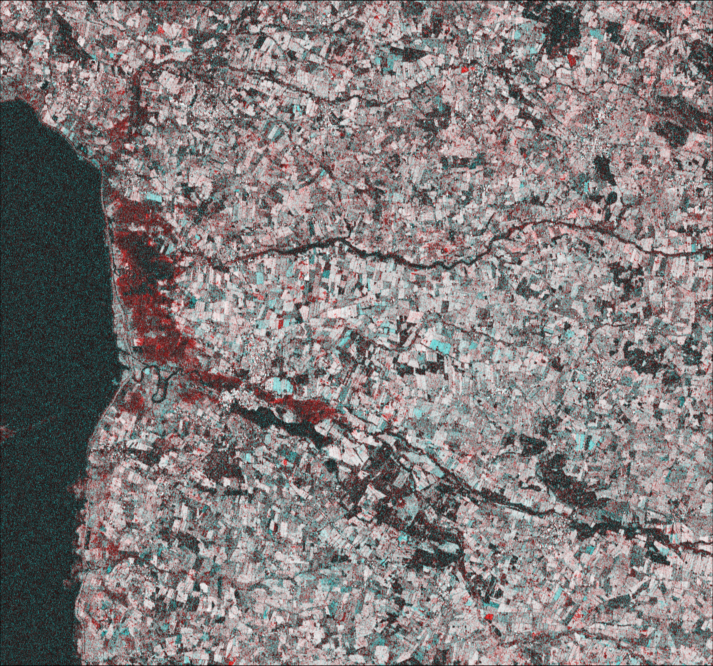

In [7]:
 img_coh = Colors.RGB.(coh[2],coh[1],coh[1])

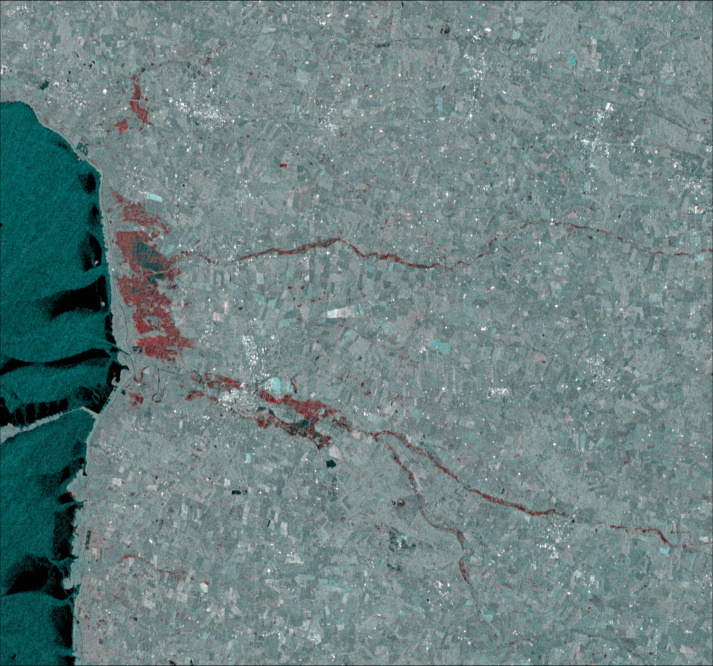

In [8]:
imgVV = pretty_img([VV_co,VV_pre],min_vv,max_vv)

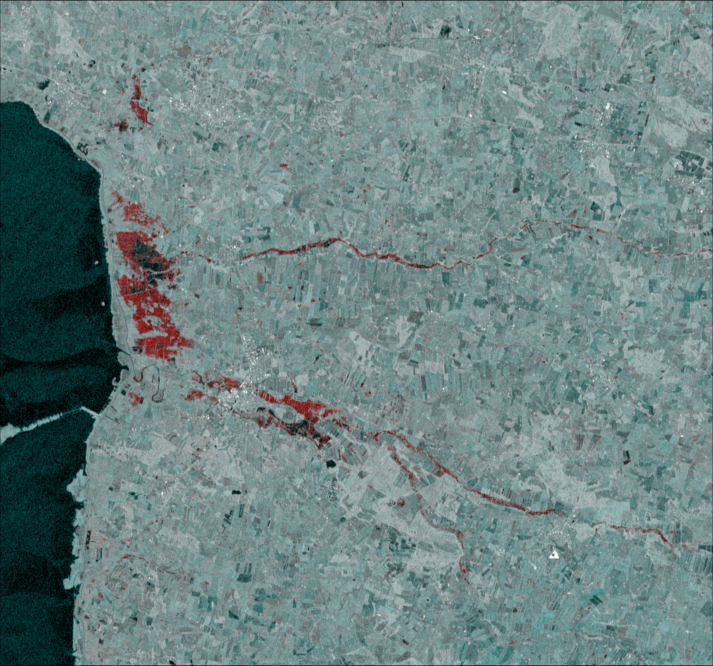

In [9]:
imgVH = pretty_img([VH_co,VH_pre],min_vh,max_vh)

In [10]:
img_bw = pretty_img([VV_pre,VV_pre],min_vv,max_vv,1);

In [11]:
VV_co = 10 .*log10.(VV_co)
VV_pre = 10 .*log10.(VV_pre)
VH_co = 10 .*log10.(VH_co)
VH_pre = 10 .*log10.(VH_pre)

delta_VV = VV_co .- VV_pre
delta_VH = VH_co .- VH_pre
delta_coh = coh[1] .- coh[2];

## Rural flooding

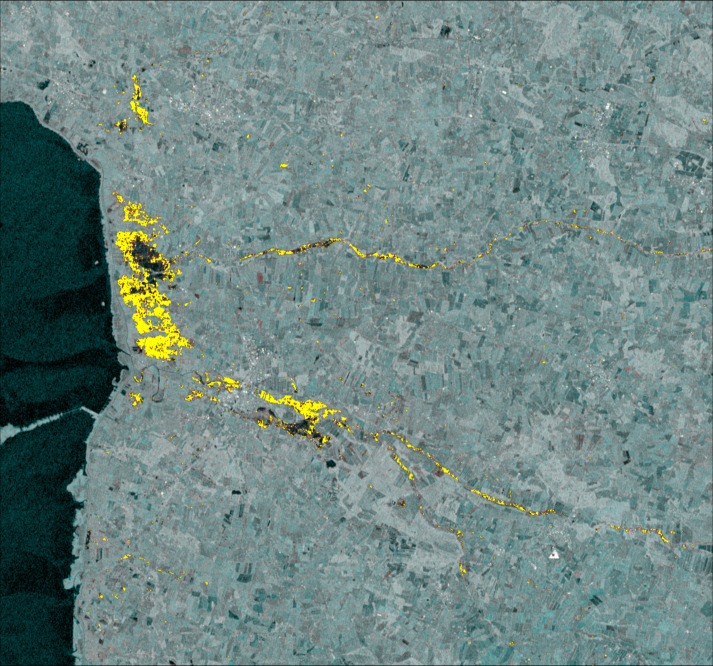

In [12]:
sure_red = (delta_VV.<-2)  .& (delta_VH.<-2) .& (VV_co .< -3) .& (VH_co .< -7);
add_mask(imgVH,sure_red ,(1,1,0))

In [13]:
sure_red_VV = vec(VV_co[sure_red])
sure_red_VH = vec(VH_co[sure_red]);

In [14]:
mu_flood = [Statistics.mean(sure_red_VV),Statistics.mean(sure_red_VH)]

2-element Array{Float64,1}:
 -15.304262626160517
 -23.013767429552082

In [15]:
sigma_flood = Statistics.cov(cat(sure_red_VV,sure_red_VH, dims=2), dims=1)

2×2 Array{Float64,2}:
 2.25078  1.44104
 1.44104  3.36252

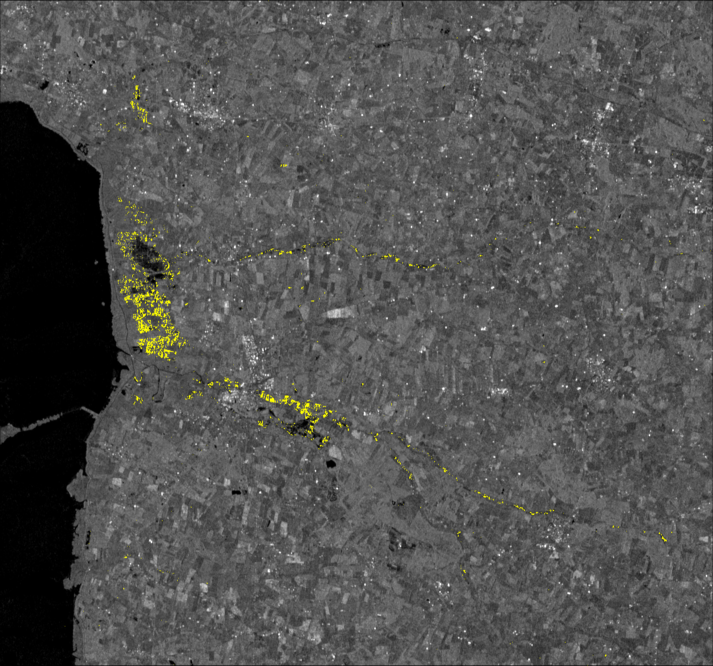

In [16]:
seed_mask = (delta_VV.<-2) .& (VV_co .< mu_flood[1]) .& (delta_VH.<-2) .& (VH_co .< mu_flood[2]);
add_mask(img_bw,seed_mask ,(1,1,0))

In [17]:
rg_mask_change = ((delta_VV.<-2) .& (delta_VH.<0)) .| 
                ((delta_VV.<0) .& (delta_VH.<-2)) .| ( ( (delta_VV .+2).^2 .+ (delta_VH .+2).^2) .< 4 );

In [18]:
test_d = collect(1:0.2:12);
dist_cir = (VV_co.-mu_flood[1]).^2 .+ (VH_co .-mu_flood[2]).^2
loss_mal = [loss_rg_fit(VV_co,VH_co, seed_mask, rg_mask_change,mu_flood,sigma_flood,dist_cir, d.^2) for d in test_d ];

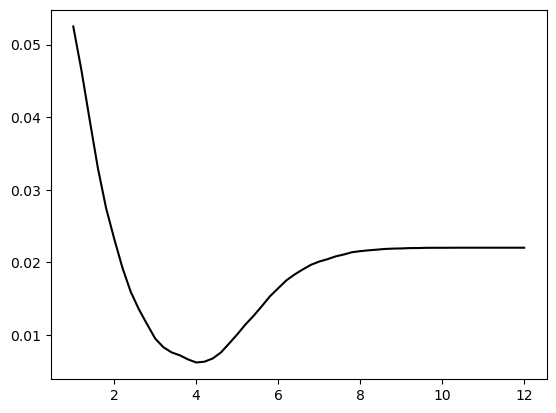

1-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f52ce5375e0>

In [19]:

PyPlot.figure()
PyPlot.plot(test_d,loss_mal,color="k")

In [20]:
res = Optim.optimize(
    d -> loss_rg_fit(VV_co,VH_co, seed_mask, rg_mask_change,mu_flood,sigma_flood,dist_cir, d.^2),
    0, 10);


In [21]:
d_min = res.minimizer

4.044591145470811

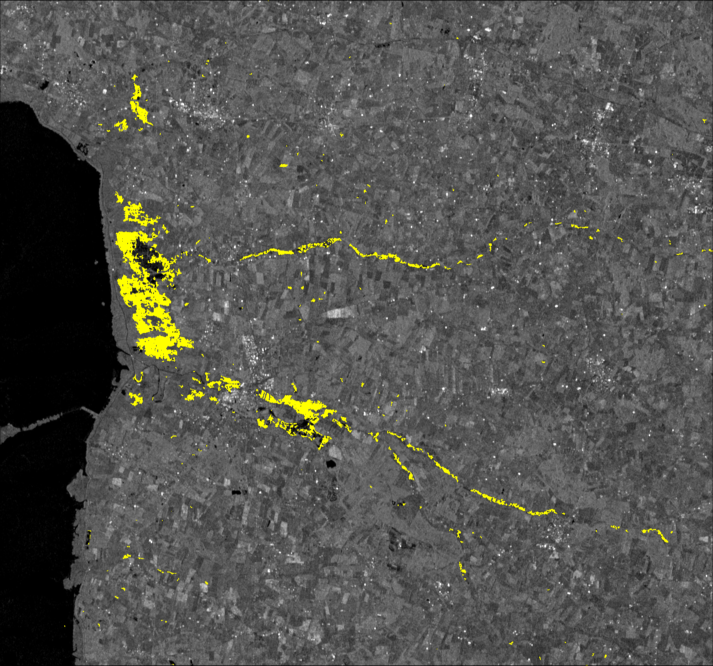

In [22]:
rg_mask_int = ((VV_co .< mu_flood[1]) .& (VH_co .< mu_flood[2])) .| (dist_cir .< d_min.^2)
flood_test,steps = region_growing(seed_mask,rg_mask_int .& rg_mask_change);
add_mask(img_bw,flood_test,(1,1,0))

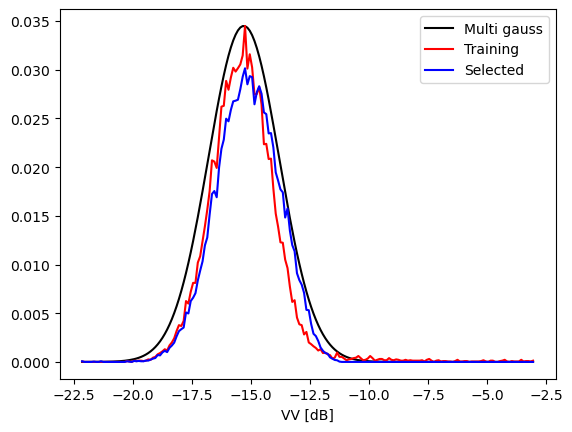

PyObject <matplotlib.legend.Legend object at 0x7f52ce4b8220>

In [23]:
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(sure_red_VV ,round(Int64,length(sure_red_VV)/100))
h = StatsBase.fit(StatsBase.Histogram, vec(VV_co[flood_test]),edges)
w2 = h.weights
w2 = w2./sum(w2)
PyPlot.figure()
PyPlot.plot(y,gauss_model(y,[maximum(w),mu_flood[1],sqrt(sigma_flood[1,1])]),color="k")

PyPlot.plot(y,w,color="r")
PyPlot.plot(y,w2,color="b")
#PyPlot.plot(y_VV2,w_VV2,color="b")
PyPlot.xlabel("VV [dB]")
PyPlot.legend(["Multi gauss","Training","Selected" ])

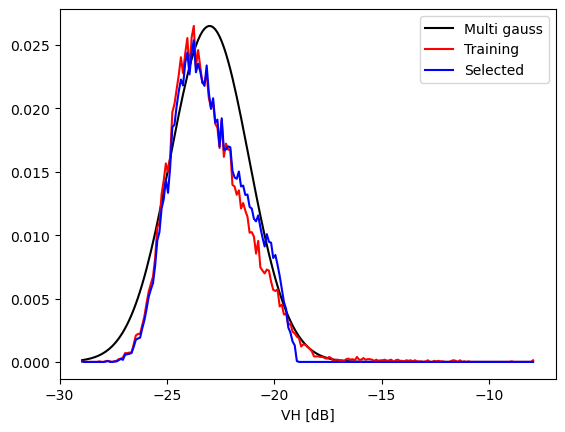

PyObject <matplotlib.legend.Legend object at 0x7f52b1a1f040>

In [24]:
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(sure_red_VH ,round(Int64,length(sure_red_VH)/100))
h = StatsBase.fit(StatsBase.Histogram, vec(VH_co[flood_test]),edges)
w2 = h.weights
w2 = w2./sum(w2)
PyPlot.figure()
PyPlot.plot(y,gauss_model(y,[maximum(w),mu_flood[2],sqrt(sigma_flood[2,2])]),color="k")

PyPlot.plot(y,w,color="r")
PyPlot.plot(y,w2,color="b")
#PyPlot.plot(y_VV2,w_VV2,color="b")
PyPlot.xlabel("VH [dB]")
PyPlot.legend(["Multi gauss","Training","Selected" ])

####  Cyan 

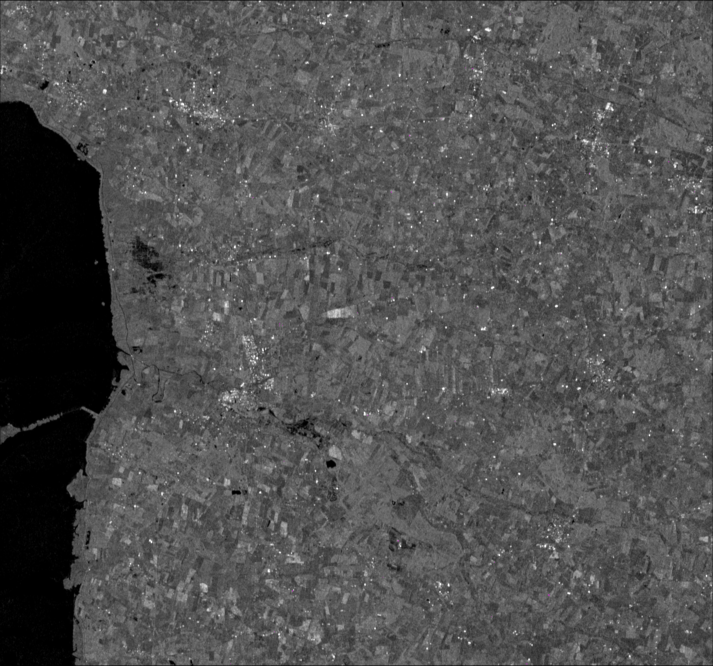

In [25]:
sure_cyan = (delta_VV.>5) .& (coh[2].> 0.5)  .& (coh[1].< 0.25) .& (VV_pre.>-10) #.& (delta_VH.> 0) 
add_mask(img_bw,sure_cyan,(1,0,1))

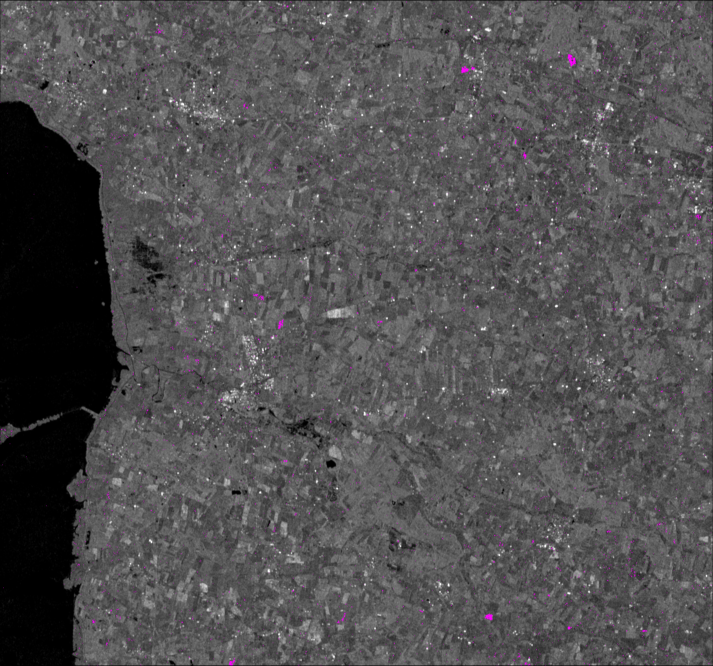

In [26]:
rg_mask = (delta_VV.>3) .& ((delta_coh .< -0.25)) #.& (coh[2].> 0.5) #.& (delta_VH.> 0) 
add_mask(img_bw,rg_mask,(1,0,1)) 

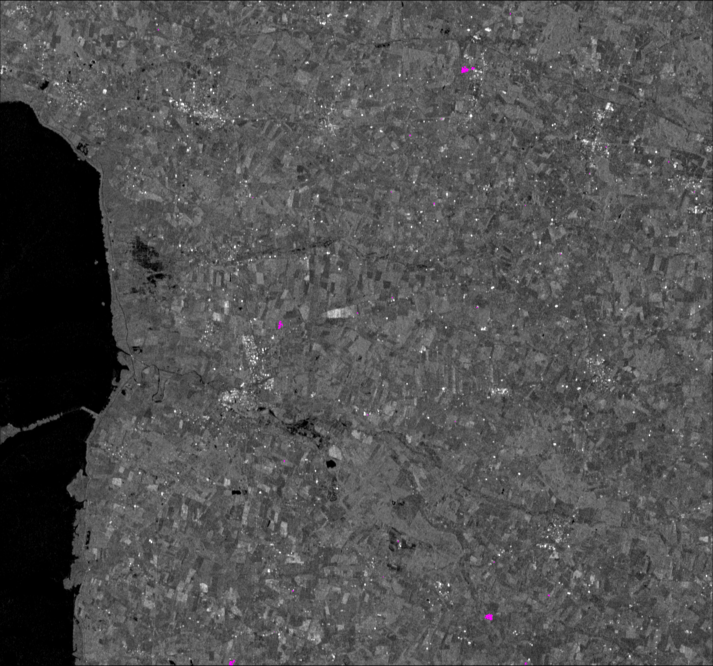

In [27]:
urban_test,steps = region_growing(sure_cyan,rg_mask );
add_mask(img_bw,urban_test ,(1,0,1))

### Final 

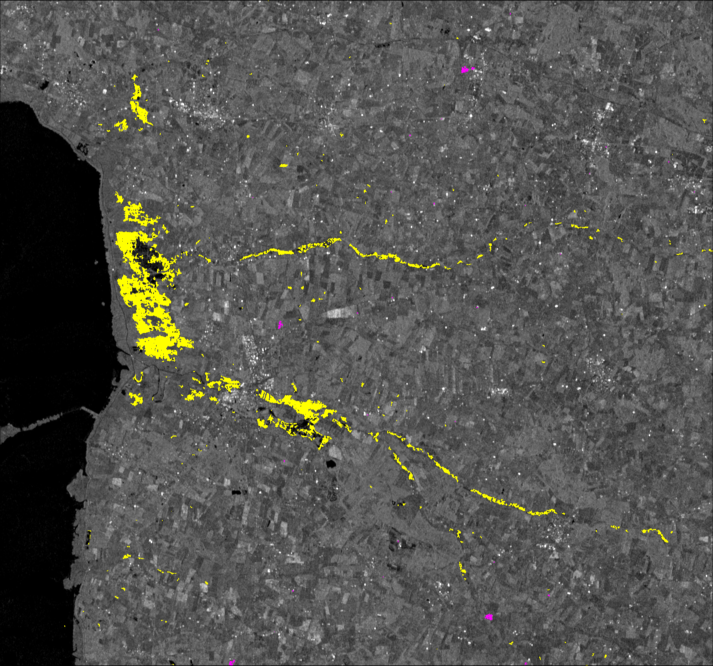

In [28]:
urban_test,steps = region_growing(sure_cyan,rg_mask );
img_final = add_mask(img_bw,urban_test ,(1,0,1))
img_final = add_mask(img_final,flood_test ,(1,1,0))

# Houston 

In [29]:
data_folder = "/home/data/simon/processed/test_areas/houston_new"
#data_folder = "/Users/simon/Documents/DTU fag/Speciale/ribe_new"
VV_files,VH_files,coherence_VV_files,coherence_VH_files = _sort_prossed_files(data_folder);
coh = [abs.(band) for band in _load_jld(coherence_VV_files[1:5],data_folder)]
coh = [coh[1][:,end:-1:1],(sum(coh[2:end])./length(coh[2:end]))[:,end:-1:1]];

In [30]:
VV = _load_jld(VV_files[1:6],data_folder)
VV_pre = dropdims(Statistics.median(cat(VV[2:end]...,dims=3),dims=3),dims=3)[:,end:-1:1];
VV_co = copy(VV[1])[:,end:-1:1]
VV = 0;


VH = _load_jld(VH_files[1:6],data_folder)
VH_pre = dropdims(Statistics.median(cat(VH[2:end]...,dims=3),dims=3),dims=3)[:,end:-1:1];
VH_co = copy(VH[1])[:,end:-1:1]
VH = 0;

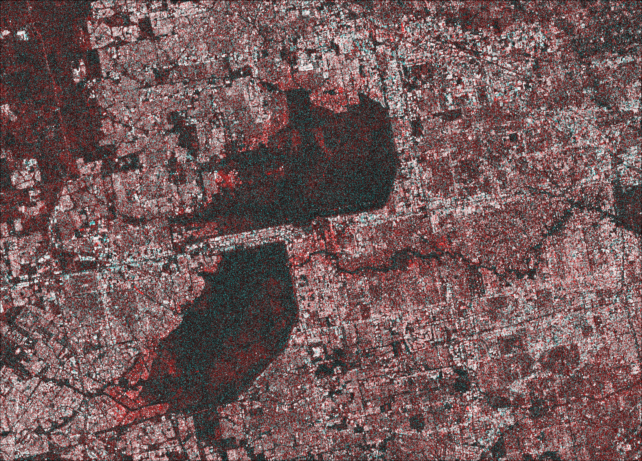

In [31]:
 img_coh = Colors.RGB.(coh[2],coh[1],coh[1])

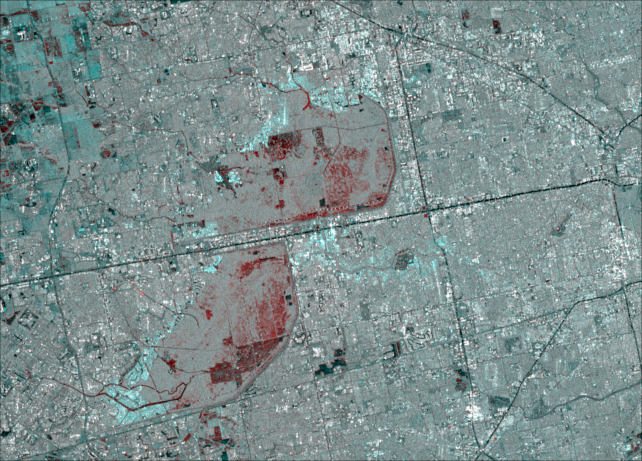

In [32]:
imgVV = pretty_img([VV_co,VV_pre],min_vv,max_vv)

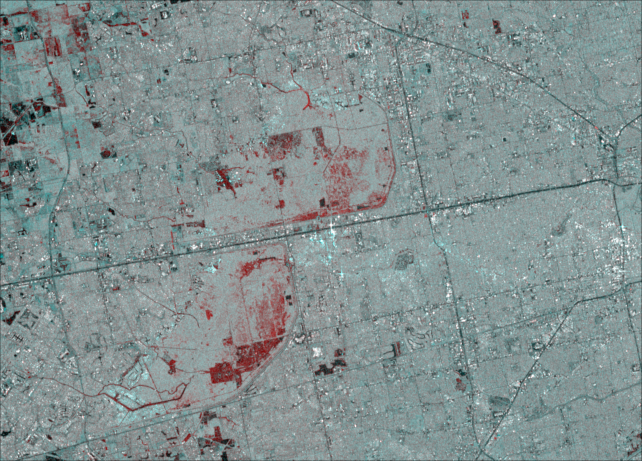

In [33]:
imgVH = pretty_img([VH_co,VH_pre],min_vh,max_vh)

In [34]:
img_bw = pretty_img([VV_pre,VV_pre],min_vv,max_vv,1);

In [35]:
VV_co = 10 .*log10.(VV_co)
VV_pre = 10 .*log10.(VV_pre)
VH_co = 10 .*log10.(VH_co)
VH_pre = 10 .*log10.(VH_pre)

delta_VV = VV_co .- VV_pre
delta_VH = VH_co .- VH_pre
delta_coh = coh[1] .- coh[2];

## Rural flooding

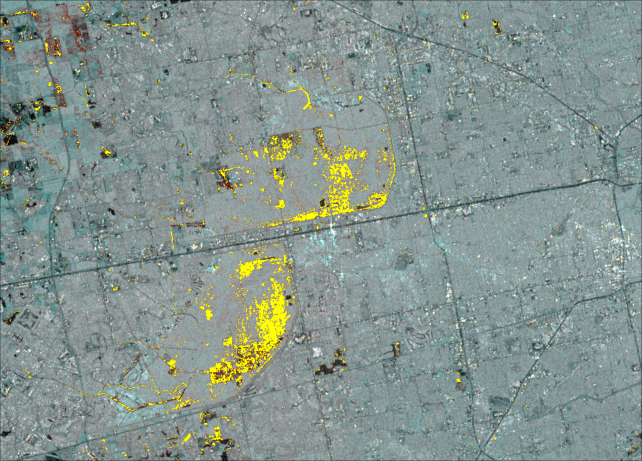

In [36]:
sure_red = (delta_VV.<-2)  .& (delta_VH.<-2) .& (VV_co .< -3) .& (VH_co .< -7);
add_mask(imgVH,sure_red ,(1,1,0))

In [37]:
sure_red_VV = vec(VV_co[sure_red])
sure_red_VH = vec(VH_co[sure_red]);

In [38]:
mu_flood = [Statistics.mean(sure_red_VV),Statistics.mean(sure_red_VH)]

2-element Array{Float64,1}:
 -15.066459042773284
 -21.05159552783195 

In [39]:
sigma_flood = Statistics.cov(cat(sure_red_VV,sure_red_VH, dims=2), dims=1)

2×2 Array{Float64,2}:
 5.76296  4.57186
 4.57186  6.24515

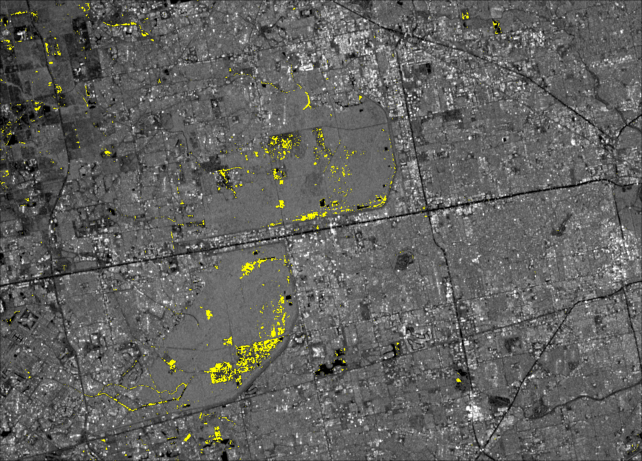

In [40]:
seed_mask = (delta_VV.<-2) .& (VV_co .< mu_flood[1]) .& (delta_VH.<-2) .& (VH_co .< mu_flood[2]);
add_mask(img_bw,seed_mask ,(1,1,0))

In [41]:
rg_mask_change = ((delta_VV.<-2) .& (delta_VH.<0)) .| 
                ((delta_VV.<0) .& (delta_VH.<-2)) .| ( ( (delta_VV .+2).^2 .+ (delta_VH .+2).^2) .< 4 );

In [42]:
dist_cir = (VV_co.-mu_flood[1]).^2 .+ (VH_co .-mu_flood[2]).^2;

In [43]:
test_d = collect(1:0.2:12);
loss_mal = [loss_rg_fit(VV_co,VH_co, seed_mask, rg_mask_change,mu_flood,sigma_flood,dist_cir, d.^2) for d in test_d ];

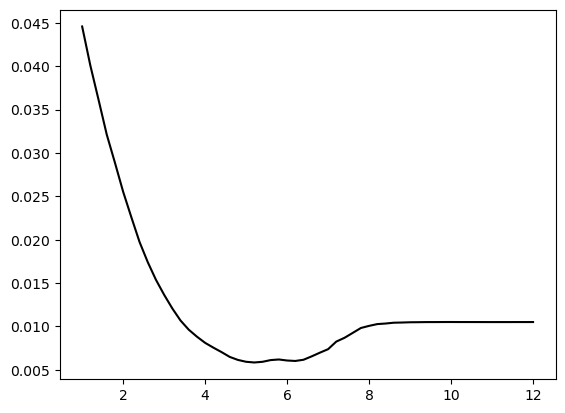

1-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f52b1987880>

In [44]:

PyPlot.figure()
PyPlot.plot(test_d,loss_mal,color="k")

In [45]:
res = Optim.optimize(
    d -> loss_rg_fit(VV_co,VH_co, seed_mask, rg_mask_change,mu_flood,sigma_flood,dist_cir, d.^2),
    0, 10);


In [46]:
d_min = res.minimizer

6.211443317162976

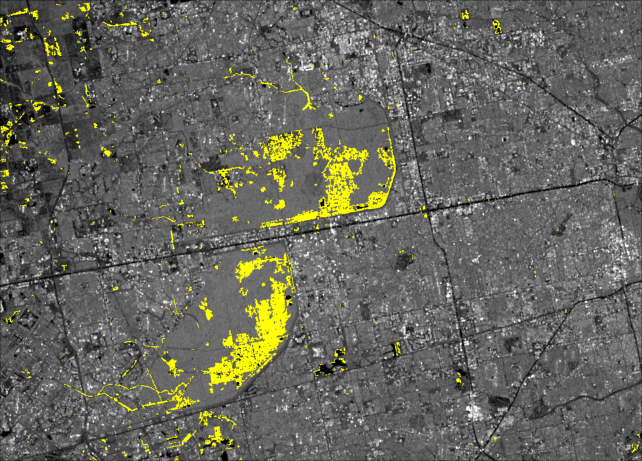

In [47]:
rg_mask_int = ((VV_co .< mu_flood[1]) .& (VH_co .< mu_flood[2])) .| (dist_cir .< d_min.^2)
flood_test,steps = region_growing(seed_mask,rg_mask_int .& rg_mask_change);
add_mask(img_bw,flood_test,(1,1,0))

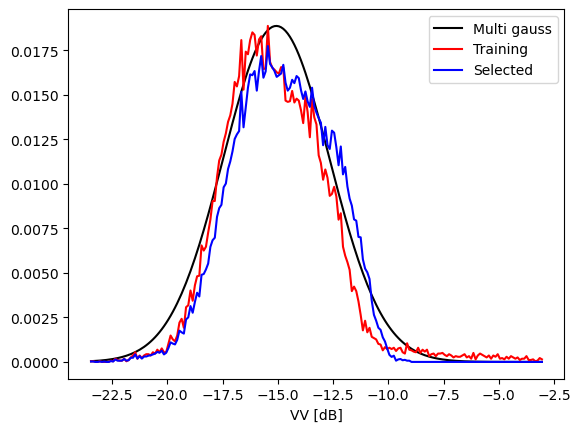

PyObject <matplotlib.legend.Legend object at 0x7f52b195bcd0>

In [48]:
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(sure_red_VV ,round(Int64,length(sure_red_VV)/100))
h = StatsBase.fit(StatsBase.Histogram, vec(VV_co[flood_test]),edges)
w2 = h.weights
w2 = w2./sum(w2)
PyPlot.figure()
PyPlot.plot(y,gauss_model(y,[maximum(w),mu_flood[1],sqrt(sigma_flood[1,1])]),color="k")

PyPlot.plot(y,w,color="r")
PyPlot.plot(y,w2,color="b")
#PyPlot.plot(y_VV2,w_VV2,color="b")
PyPlot.xlabel("VV [dB]")
PyPlot.legend(["Multi gauss","Training","Selected" ])

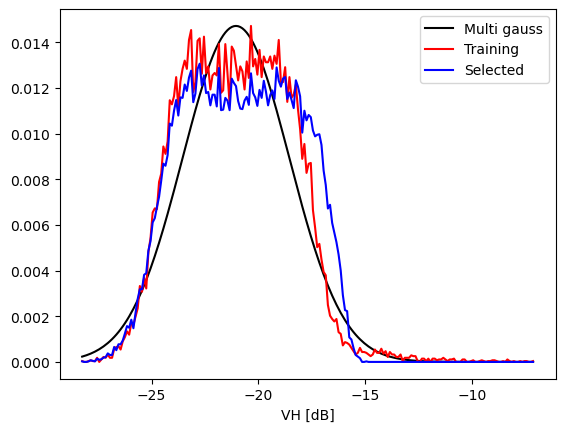

PyObject <matplotlib.legend.Legend object at 0x7f52b18d0130>

In [49]:
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(sure_red_VH ,round(Int64,length(sure_red_VH)/100))
h = StatsBase.fit(StatsBase.Histogram, vec(VH_co[flood_test]),edges)
w2 = h.weights
w2 = w2./sum(w2)
PyPlot.figure()
PyPlot.plot(y,gauss_model(y,[maximum(w),mu_flood[2],sqrt(sigma_flood[2,2])]),color="k")

PyPlot.plot(y,w,color="r")
PyPlot.plot(y,w2,color="b")
#PyPlot.plot(y_VV2,w_VV2,color="b")
PyPlot.xlabel("VH [dB]")
PyPlot.legend(["Multi gauss","Training","Selected" ])

####  Cyan 

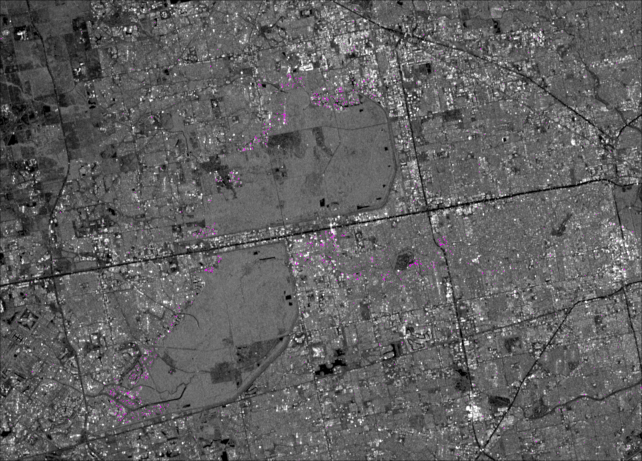

In [50]:
sure_cyan = (delta_VV.>5) .& (coh[2].> 0.5)  .& (coh[1].< 0.25) .& (VV_pre.>-10) #.& (delta_VH.> 0) 
add_mask(img_bw,sure_cyan,(1,0,1))

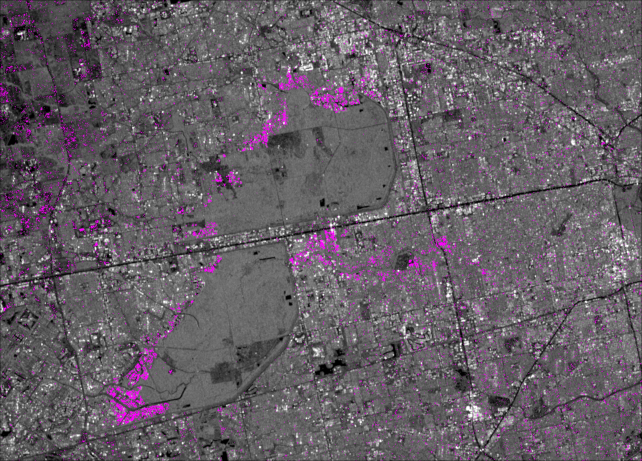

In [51]:
rg_mask = (delta_VV.>3) .& ((delta_coh .< -0.25)) #.& (coh[2].> 0.5) #.& (delta_VH.> 0) .& (coh[2].> 0.5)
add_mask(img_bw,rg_mask,(1,0,1)) 

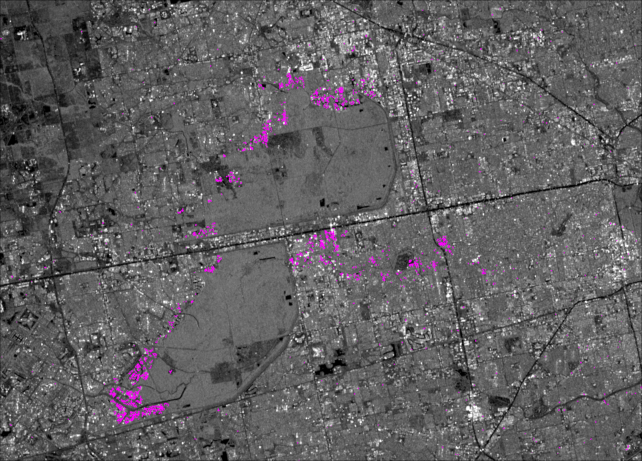

In [52]:
urban_test,steps = region_growing(sure_cyan,rg_mask );
add_mask(img_bw,urban_test ,(1,0,1))

### Final 

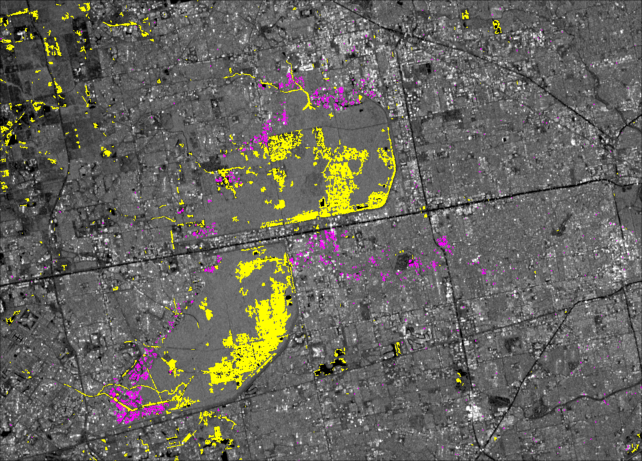

In [53]:
urban_test,steps = region_growing(sure_cyan,rg_mask );
img_final = add_mask(img_bw,urban_test ,(1,0,1))
img_final = add_mask(img_final,flood_test ,(1,1,0))

# Vejle

In [54]:
data_folder = "/home/data/simon/processed/test_areas/vejle_new"
#data_folder = "/Users/simon/Documents/DTU fag/Speciale/ribe_new"
VV_files,VH_files,coherence_VV_files,coherence_VH_files = _sort_prossed_files(data_folder);
coh = [abs.(band) for band in _load_jld(coherence_VV_files[1:5],data_folder)]
coh = [coh[1][:,end:-1:1],(sum(coh[2:end])./length(coh[2:end]))[:,end:-1:1]];

In [55]:
VV = _load_jld(VV_files[1:6],data_folder)
VV_pre = dropdims(Statistics.median(cat(VV[2:end]...,dims=3),dims=3),dims=3)[:,end:-1:1];
VV_co = copy(VV[1])[:,end:-1:1]
VV = 0;


VH = _load_jld(VH_files[1:6],data_folder)
VH_pre = dropdims(Statistics.median(cat(VH[2:end]...,dims=3),dims=3),dims=3)[:,end:-1:1];
VH_co = copy(VH[1])[:,end:-1:1]
VH = 0;

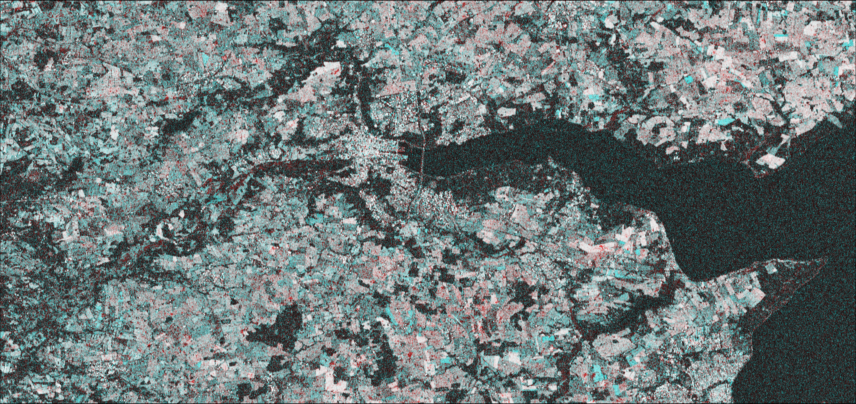

In [56]:
 img_coh = Colors.RGB.(coh[2],coh[1],coh[1])

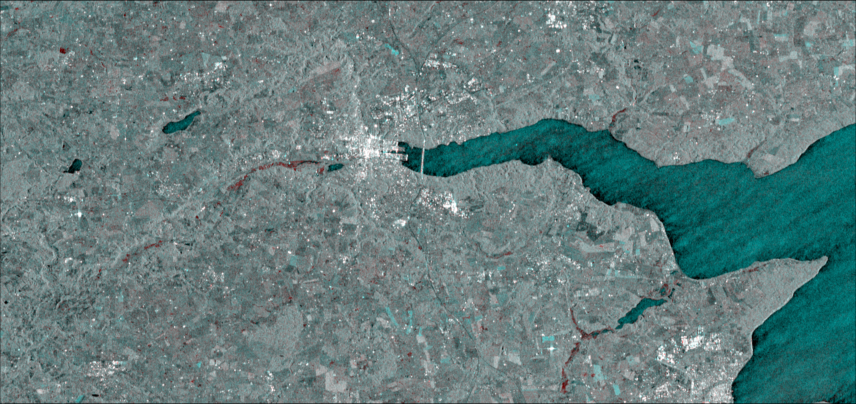

In [57]:
imgVV = pretty_img([VV_co,VV_pre],min_vv,max_vv)

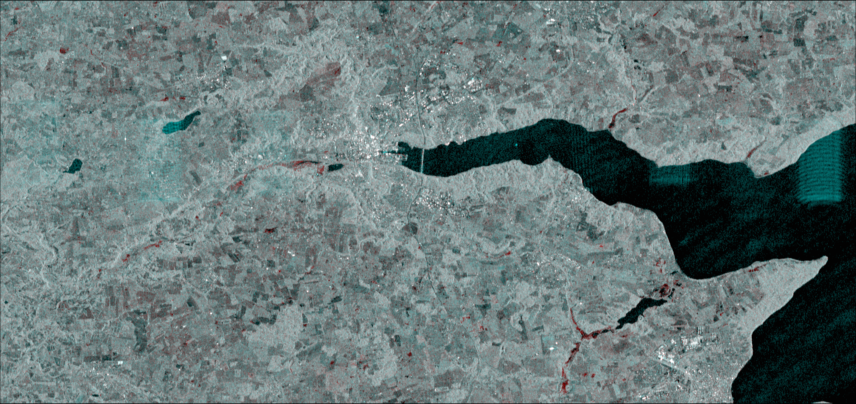

In [58]:
imgVH = pretty_img([VH_co,VH_pre],min_vh,max_vh)

In [59]:
img_bw = pretty_img([VV_pre,VV_pre],min_vv,max_vv,1);

In [60]:
VV_co = 10 .*log10.(VV_co)
VV_pre = 10 .*log10.(VV_pre)
VH_co = 10 .*log10.(VH_co)
VH_pre = 10 .*log10.(VH_pre)

delta_VV = VV_co .- VV_pre
delta_VH = VH_co .- VH_pre
delta_coh = coh[1] .- coh[2];

## Rural flooding

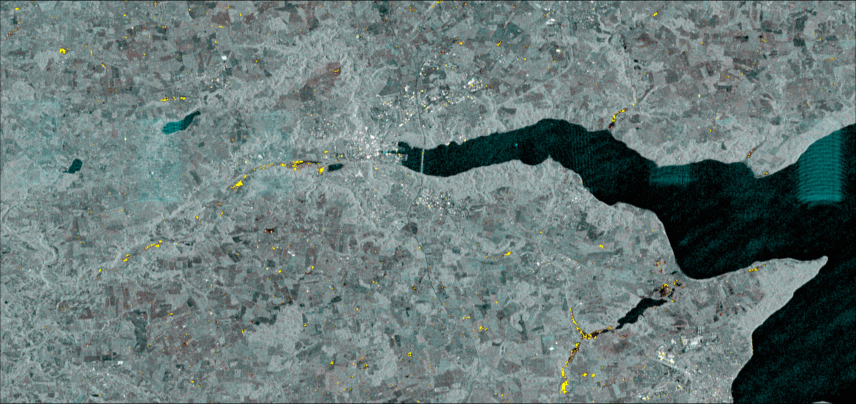

In [61]:
sure_red = (delta_VV.<-2)  .& (delta_VH.<-2) .& (VV_co .< -3) .& (VH_co .< -7);
add_mask(imgVH,sure_red ,(1,1,0))

In [62]:
sure_red_VV = vec(VV_co[sure_red])
sure_red_VH = vec(VH_co[sure_red]);

In [63]:
mu_flood = [Statistics.mean(sure_red_VV),Statistics.mean(sure_red_VH)]

2-element Array{Float64,1}:
 -14.886845056490364
 -21.948631091157434

In [64]:
sigma_flood = Statistics.cov(cat(sure_red_VV,sure_red_VH, dims=2), dims=1)

2×2 Array{Float64,2}:
 9.3552   6.81768
 6.81768  8.46589

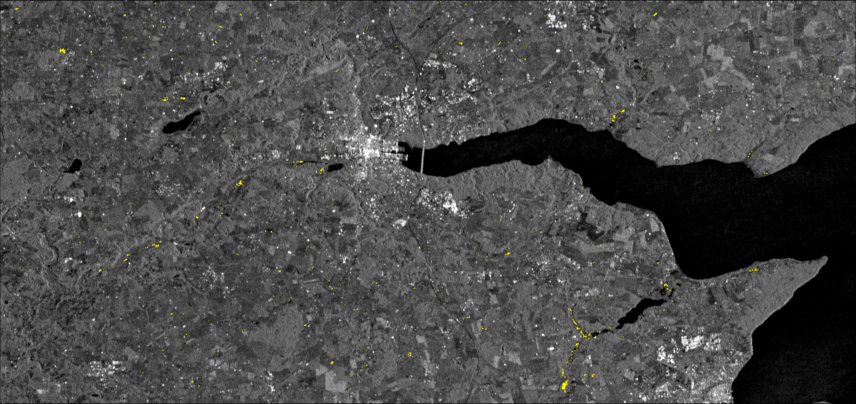

In [65]:
seed_mask = (delta_VV.<-2) .& (VV_co .< mu_flood[1]) .& (delta_VH.<-2) .& (VH_co .< mu_flood[2]);
add_mask(img_bw,seed_mask ,(1,1,0))

In [66]:
rg_mask_change = ((delta_VV.<-2) .& (delta_VH.<0)) .| 
                ((delta_VV.<0) .& (delta_VH.<-2)) .| ( ( (delta_VV .+2).^2 .+ (delta_VH .+2).^2) .< 4 );

In [67]:
test_d = collect(1:0.2:12);
dist_cir = (VV_co.-mu_flood[1]).^2 .+ (VH_co .-mu_flood[2]).^2
loss_mal = [loss_rg_fit(VV_co,VH_co, seed_mask, rg_mask_change,mu_flood,sigma_flood,dist_cir, d.^2) for d in test_d ];

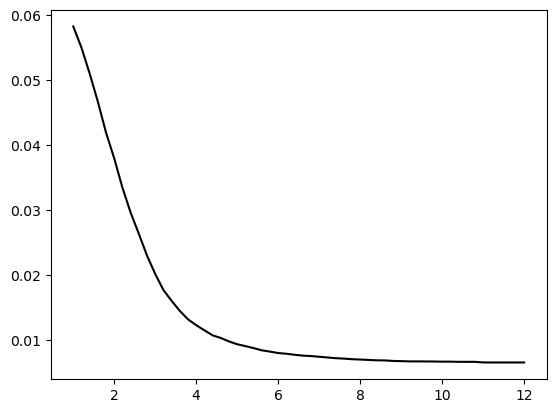

1-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.lines.Line2D object at 0x7f52b1848160>

In [68]:

PyPlot.figure()
PyPlot.plot(test_d,loss_mal,color="k")

In [69]:
res = Optim.optimize(
    d -> loss_rg_fit(VV_co,VH_co, seed_mask, rg_mask_change,mu_flood,sigma_flood,dist_cir, d.^2),
    0, 10);


In [70]:
d_min = res.minimizer

7.639320401879111

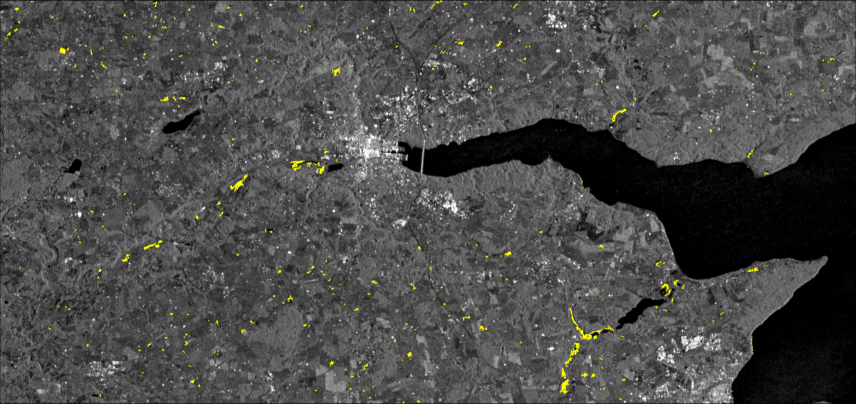

In [71]:
rg_mask_int = ((VV_co .< mu_flood[1]) .& (VH_co .< mu_flood[2])) .| (dist_cir .< d_min.^2)
flood_test,steps = region_growing(seed_mask,rg_mask_int .& rg_mask_change);
add_mask(img_bw,flood_test,(1,1,0))

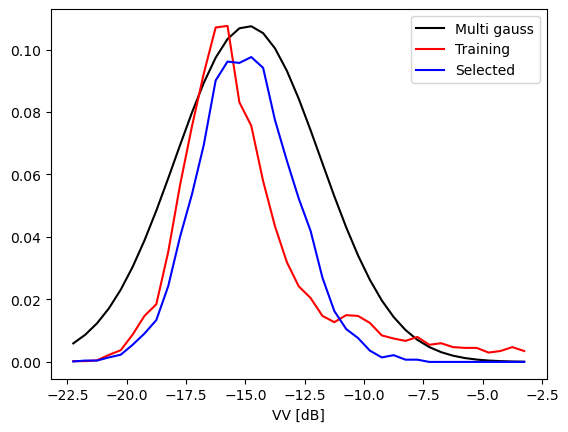

PyObject <matplotlib.legend.Legend object at 0x7f52b18124f0>

In [72]:
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(sure_red_VV ,round(Int64,length(sure_red_VV)/100))
h = StatsBase.fit(StatsBase.Histogram, vec(VV_co[flood_test]),edges)
w2 = h.weights
w2 = w2./sum(w2)
PyPlot.figure()
PyPlot.plot(y,gauss_model(y,[maximum(w),mu_flood[1],sqrt(sigma_flood[1,1])]),color="k")

PyPlot.plot(y,w,color="r")
PyPlot.plot(y,w2,color="b")
#PyPlot.plot(y_VV2,w_VV2,color="b")
PyPlot.xlabel("VV [dB]")
PyPlot.legend(["Multi gauss","Training","Selected" ])

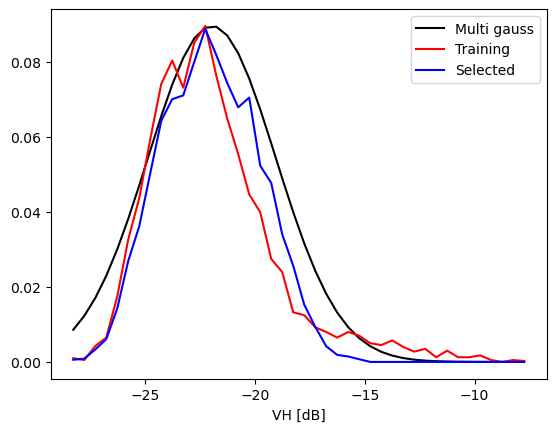

PyObject <matplotlib.legend.Legend object at 0x7f52b177ccd0>

In [73]:
p_fit,y,w,edges, w_sum = fit_bimodal_gauss(sure_red_VH ,round(Int64,length(sure_red_VH)/100))
h = StatsBase.fit(StatsBase.Histogram, vec(VH_co[flood_test]),edges)
w2 = h.weights
w2 = w2./sum(w2)
PyPlot.figure()
PyPlot.plot(y,gauss_model(y,[maximum(w),mu_flood[2],sqrt(sigma_flood[2,2])]),color="k")

PyPlot.plot(y,w,color="r")
PyPlot.plot(y,w2,color="b")
#PyPlot.plot(y_VV2,w_VV2,color="b")
PyPlot.xlabel("VH [dB]")
PyPlot.legend(["Multi gauss","Training","Selected" ])

####  Cyan 

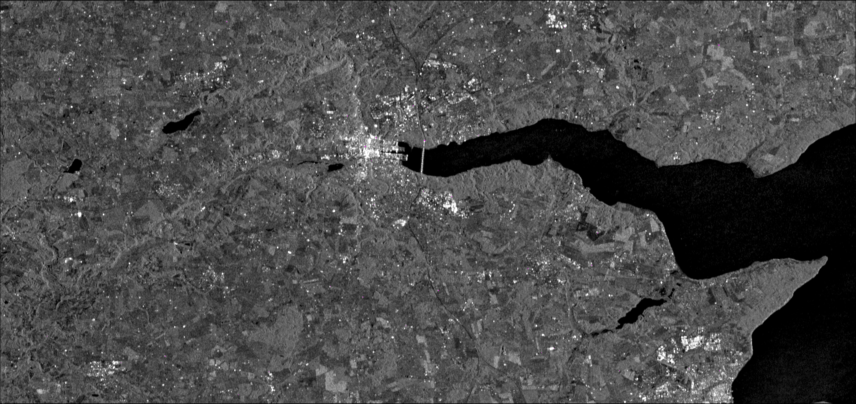

In [74]:
sure_cyan = (delta_VV.>5) .& (coh[2].> 0.5)  .& (coh[1].< 0.25) .& (VV_pre.>-10) #.& (delta_VH.> 0) 
add_mask(img_bw,sure_cyan,(1,0,1))

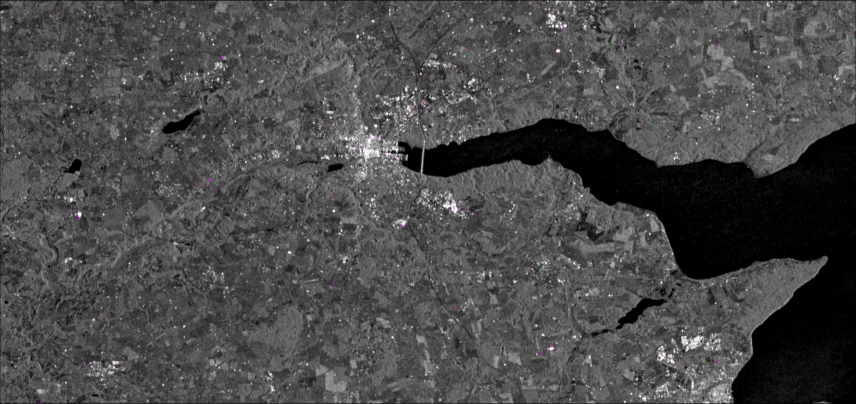

In [75]:
rg_mask = (delta_VV.>3) .& ((delta_coh .< -0.25)) #.& (delta_VH.> 0) 
add_mask(img_bw,rg_mask,(1,0,1)) 

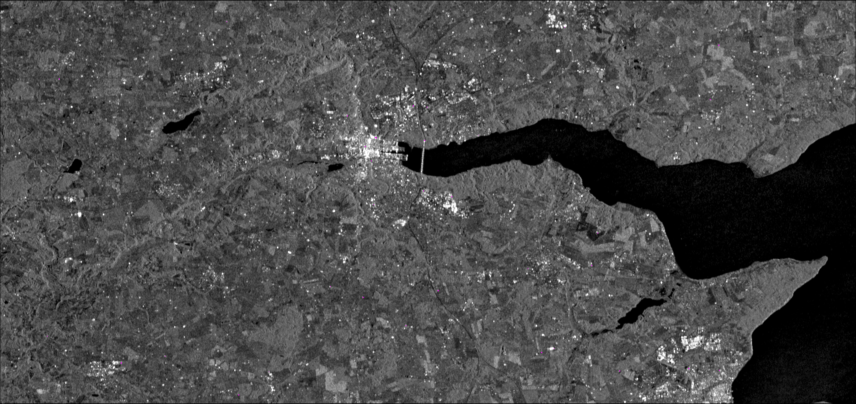

In [76]:
urban_test,steps = region_growing(sure_cyan,rg_mask );
add_mask(img_bw,urban_test ,(1,0,1))

### Final 

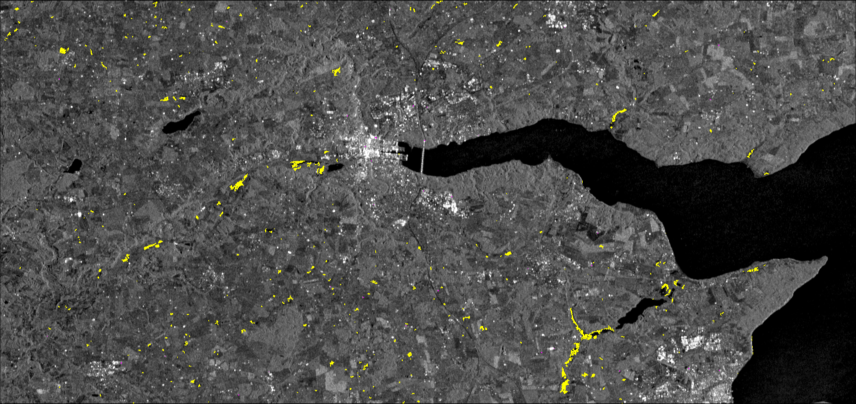

In [77]:
urban_test,steps = region_growing(sure_cyan,rg_mask );
img_final = add_mask(img_bw,urban_test ,(1,0,1))
img_final = add_mask(img_final,flood_test ,(1,1,0))